# O Método de Taylor de Ordem $q$

Vamos resolver o problema de valor inicial $$ \left\{ \begin{array}{l} y' = -y + x + 2, \quad [0, 0.3] \\
y(0) = 2\end{array} \right. $$ utilizando o Método de Taylor de ordem 3. Assim, vamos considerar $$y_{n+1}=y_n + h f_n \frac{h^2}{2} f'_n + \frac{h^3}{3!}f''_n.$$

In [76]:
using Plots, LinearAlgebra

In [77]:
f(x,y) = -y+x+2
df(x,y) = y - x -1
ddf(x,y) = -y + x + 1

ddf (generic function with 1 method)

In [78]:
x0 = 0
xf = 0.3
dx = 0.01
y0 = 2

2

In [79]:
ϕ(x,y) = y + dx * f(x,y)+dx^2/2 * df(x,y)+dx^3/6 * ddf(x,y)

ϕ (generic function with 1 method)

In [80]:
x = Float64[]
y = Float64[]

push!(x,x0)
push!(y,y0)

t = x0
yn = y0;

while t <= xf
    yn = ϕ(t,yn);
    push!(y,yn);
    t = t + dx;
    push!(x,t)
end

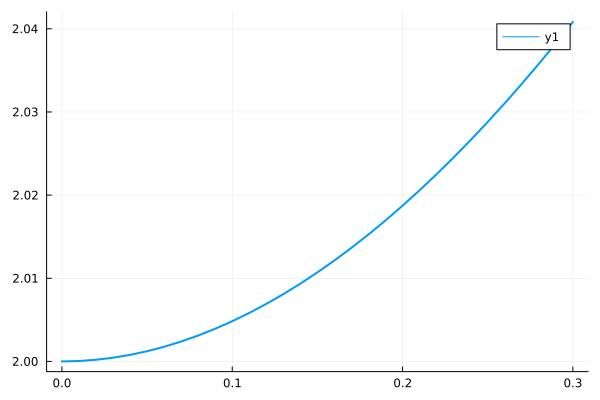

In [81]:
plot(x,y,lw=2)

In [82]:
# Solução Exata
ex(x) = exp(-x) + x + 1

ex (generic function with 1 method)

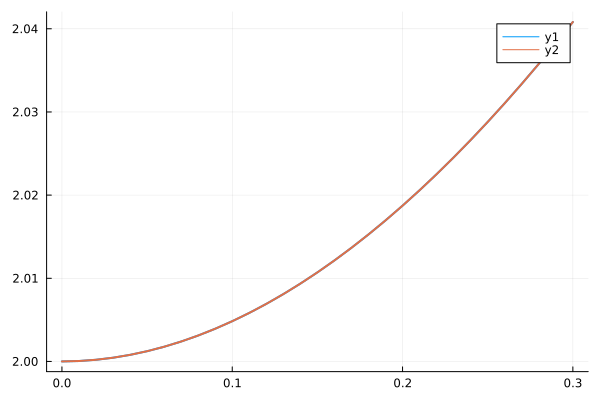

In [83]:
plot!(x,ex.(x),lw=2)

## O Sistema Presa-Predador

Vamos implementar o método de Taylor de ordem 3 para resolver o sistema presa predador $$\left\{ \begin{array}{l}  x_1' = (a-bx_2)x_1\\ x_2'=(-c+dx_1)x_2\end{array} \right.$$ Antes, notamos que o sistema acima possui duas singularidades $(0,0)$ e $(c/d,a/b)$.

Definição de algumas funções e parâmetros

In [84]:
t0 = 0.0;
tf = 50.0;
n = 300000;
x0 = 1.0;
y0 = 2.0;
f1(t,x,y) = x - 0.5 * x * y;
f2(t,x,y) = -0.75 * y + 0.25 * x * y;


In [85]:
function siseuler2(t0,tf,n,x0,y0,f1,f2)
    t = Float64[];
    x = Float64[];
    y = Float64[];
    push!(t,t0);
    push!(x,x0);
    push!(y,y0);

    h = (tf - t0) / n;

    tmp = t0;
    
    while tmp <= tf
        newx = x[end] + h * f1(tmp,x[end],y[end]);
        newy = y[end] + h * f2(tmp,x[end],y[end]);
        push!(x,newx);
        push!(y,newy);
        tmp = tmp + h;
        push!(t,tmp);
    end

    return(t,x,y);
end    

siseuler2 (generic function with 1 method)

In [89]:
(t,x1,y1) = siseuler2(t0,tf,n,1,1,f1,f2);
(t,x2,y2) = siseuler2(t0,tf,n,1,2,f1,f2);
(t,x3,y3) = siseuler2(t0,tf,n,2,2,f1,f2);
(t,x4,y4) = siseuler2(t0,tf,n,3,1,f1,f2);

In [87]:
plot(t,x1)
plot!(t,y1)

In [92]:
plot(x1,y1,lw=2,leg=false)
plot!(x2,y2,lw=2)
plot!(x3,y3,lw=2)
plot!(x4,y4,lw=2)
